# Road Networks

Data source: https://osdatahub.os.uk/downloads/open/OpenRoads

In [1]:
import pandas as pd
import geopandas as gpd

from lets_plot import *
from lets_plot.geo_data import *

The geodata is provided by © OpenStreetMap contributors and is made available here under the Open Database License (ODbL).



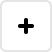
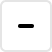
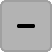
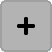
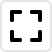
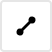
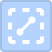
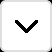
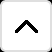
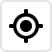

In [2]:
LetsPlot.setup_html()

In [3]:
roads_gdf = gpd.read_file("data/roads.geojson")
print(roads_gdf.shape)
roads_gdf.head()

(3672707, 4)


,length,id,county,geometry
0,93,SO,Herefordshire,"LINESTRING (-2.37458 52.06031, -2.37455 52.059..."
1,695,SO,Herefordshire,"LINESTRING (-2.37458 52.06031, -2.37385 52.060..."
2,439,SO,Herefordshire,"LINESTRING (-2.37702 52.06392, -2.37604 52.062..."
3,66,SO,Herefordshire,"LINESTRING (-2.35892 52.06354, -2.35939 52.063..."
4,146,SO,Herefordshire,"LINESTRING (-2.35892 52.06354, -2.35898 52.063..."


In [4]:
uk_gdf = geocode_counties().scope("UK").inc_res(3).get_boundaries()
uk_gdf.head()

,county,found name,geometry
0,Herefordshire,Herefordshire,"MULTIPOLYGON (((-2.57080 51.86292, -2.57080 51..."
1,Suffolk,Suffolk,"MULTIPOLYGON (((1.49414 52.05249, 1.47217 52.0..."
2,London,London,"MULTIPOLYGON (((-0.50537 51.46770, -0.50537 51..."
3,Hertfordshire,Hertfordshire,"MULTIPOLYGON (((-0.19775 51.65893, -0.21973 51..."
4,Norfolk,Norfolk,"MULTIPOLYGON (((1.73584 52.54964, 1.73584 52.5..."


In [5]:
counts_df = roads_gdf["county"].value_counts().to_frame().reset_index()
counts_df.columns = ["county", "count"]
print(counts_df.shape)
counts_df.head()

(231, 2)


,county,count
0,London,210537
1,Greater Manchester,148486
2,West Yorkshire,129027
3,West Midlands Combined Authority,104366
4,Hampshire,92224


In [6]:
ggplot() + \
    geom_map(aes(fill="count"), data=counts_df, map=uk_gdf, map_join=["county", "found name"], \
             tooltips=layer_tooltips().title("@county").line("@|@count")) + \
    scale_fill_gradient2(low="green", mid="yellow", high="red", midpoint=10_000) + \
    ggsize(1000, 1000) + \
    theme_classic() + theme(axis='blank')

In [7]:
def crop_gdf(input_gdf, *, limit=4_000, col="length"):
    return input_gdf.sort_values(by=col, ascending=False).iloc[:limit].reset_index(drop=True)

In [8]:
def filter_gdf(gdf, county, *, crop_size=None, print_data_info=False):
    result_gdf = roads_gdf[roads_gdf["county"] == county]
    if crop_size is not None:
        result_gdf = crop_gdf(result_gdf, limit=crop_size)
    if print_data_info:
        print(set(result_gdf["id"].unique()))
        print(result_gdf.shape)
        print(result_gdf.head())
    return result_gdf, county

In [9]:
def target_plot(target_gdf, target_name, width=800, height=800):
    return ggplot() + \
        geom_path(aes(color="length"), map=target_gdf) + \
        scale_color_gradient(low="#8856a7", high="#e0ecf4", \
                             trans="log10", guide='none') + \
        ggsize(width, height) + \
        ggtitle("{0} road network".format(target_name)) + \
        theme_classic() + theme(axis='blank') + flavor_high_contrast_dark()

In [10]:
target_plot(*filter_gdf(roads_gdf, "Cardiff"))

In [11]:
target_plot(*filter_gdf(roads_gdf, "City of Bristol"))

In [12]:
target_plot(*filter_gdf(roads_gdf, "Windsor and Maidenhead"))

In [13]:
target_plot(*filter_gdf(roads_gdf, "York"))

In [14]:
target_plot(*filter_gdf(roads_gdf, "Glasgow City"))

In [15]:
target_plot(*filter_gdf(roads_gdf, "City of Nottingham"))

In [16]:
target_plot(*filter_gdf(roads_gdf, "Orkney Islands"))